In [2]:
#CONDA ENV: base_conda
#Import packages
#---------------------------------------
import sys
import os
import glob
import pandas as pd
from matplotlib import pyplot as plt
import numpy as np
import scanpy as sc
os.environ["HDF5_USE_FILE_LOCKING"] = "FALSE"

#Import your modules
#---------------------------------------
sys.path.insert(1, '/cndd3/dburrows/CODE/admin_tools/')
from admin_tools import admin_functions as adm


# Define paths
#----------------------------------------------------------------------
l_code = '/Users/dominicburrows/Dropbox/PhD/Analysis/my_scripts/GitHub/'
l_data = '/Users/dominicburrows/Dropbox/PhD/analysis/Project/'
l_fig = '/Users/dominicburrows/Dropbox/PhD/figures/'

s_code = '/cndd3/dburrows/CODE/'
s_data = '/cndd3/dburrows/DATA/'
s_fig = '/cndd3/dburrows/FIGS/'

%load_ext autoreload
sys.version

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


'3.9.7 | packaged by conda-forge | (default, Sep 29 2021, 19:23:11) \n[GCC 9.4.0]'

In [3]:
# Load in data
#---------------------------------------
rna_data = sc.read_h5ad('/cndd3/dburrows/DATA/singlecell_HIVOUD/RNA_230828_PFC_13samples_HVWs_combined.h5ad')
atac_data = sc.read_h5ad('/cndd3/dburrows/DATA/singlecell_HIVOUD/ATAC_230828_PFC_13samples_HVWs_combined.h5ad')

In [4]:
rna_data

AnnData object with n_obs × n_vars = 118677 × 36611
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_RNA_raw', 'nFeature_RNA_raw', 'nCount_ATAC', 'nFeature_ATAC', 'gex_raw_reads', 'gex_mapped_reads', 'gex_conf_intergenic_reads', 'gex_conf_exonic_reads', 'gex_conf_intronic_reads', 'gex_conf_exonic_unique_reads', 'gex_conf_exonic_antisense_reads', 'gex_conf_exonic_dup_reads', 'gex_exonic_umis', 'gex_conf_intronic_unique_reads', 'gex_conf_intronic_antisense_reads', 'gex_conf_intronic_dup_reads', 'gex_intronic_umis', 'gex_conf_txomic_unique_reads', 'gex_umis_count', 'gex_genes_count', 'atac_raw_reads', 'atac_unmapped_reads', 'atac_lowmapq', 'atac_dup_reads', 'atac_chimeric_reads', 'atac_mitochondrial_reads', 'atac_fragments', 'atac_TSS_fragments', 'atac_peak_region_fragments', 'atac_peak_region_cutsites', 'TSS.enrichment', 'TSS.percentile', 'nCount_SCT', 'nFeature_SCT', 'SCT.weight', 'ATAC.weight', 'wsnn_res.0.2', 'seurat_clusters', 'log_nCount_ATAC', 'log_nCount_

In [5]:
atac_data

AnnData object with n_obs × n_vars = 118677 × 50000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_RNA_raw', 'nFeature_RNA_raw', 'nCount_ATAC', 'nFeature_ATAC', 'gex_raw_reads', 'gex_mapped_reads', 'gex_conf_intergenic_reads', 'gex_conf_exonic_reads', 'gex_conf_intronic_reads', 'gex_conf_exonic_unique_reads', 'gex_conf_exonic_antisense_reads', 'gex_conf_exonic_dup_reads', 'gex_exonic_umis', 'gex_conf_intronic_unique_reads', 'gex_conf_intronic_antisense_reads', 'gex_conf_intronic_dup_reads', 'gex_intronic_umis', 'gex_conf_txomic_unique_reads', 'gex_umis_count', 'gex_genes_count', 'atac_raw_reads', 'atac_unmapped_reads', 'atac_lowmapq', 'atac_dup_reads', 'atac_chimeric_reads', 'atac_mitochondrial_reads', 'atac_fragments', 'atac_TSS_fragments', 'atac_peak_region_fragments', 'atac_peak_region_cutsites', 'TSS.enrichment', 'TSS.percentile', 'nCount_SCT', 'nFeature_SCT', 'SCT.weight', 'ATAC.weight', 'wsnn_res.0.2', 'seurat_clusters', 'log_nCount_ATAC', 'log_nCount_

# Visualise dimensionality reduction + clustering

In [14]:
rna_data.obs.columns.unique

<bound method Index.unique of Index(['orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt',
       'nCount_RNA_raw', 'nFeature_RNA_raw', 'nCount_ATAC', 'nFeature_ATAC',
       'gex_raw_reads', 'gex_mapped_reads', 'gex_conf_intergenic_reads',
       'gex_conf_exonic_reads', 'gex_conf_intronic_reads',
       'gex_conf_exonic_unique_reads', 'gex_conf_exonic_antisense_reads',
       'gex_conf_exonic_dup_reads', 'gex_exonic_umis',
       'gex_conf_intronic_unique_reads', 'gex_conf_intronic_antisense_reads',
       'gex_conf_intronic_dup_reads', 'gex_intronic_umis',
       'gex_conf_txomic_unique_reads', 'gex_umis_count', 'gex_genes_count',
       'atac_raw_reads', 'atac_unmapped_reads', 'atac_lowmapq',
       'atac_dup_reads', 'atac_chimeric_reads', 'atac_mitochondrial_reads',
       'atac_fragments', 'atac_TSS_fragments', 'atac_peak_region_fragments',
       'atac_peak_region_cutsites', 'TSS.enrichment', 'TSS.percentile',
       'nCount_SCT', 'nFeature_SCT', 'SCT.weight', 'ATAC.weight',

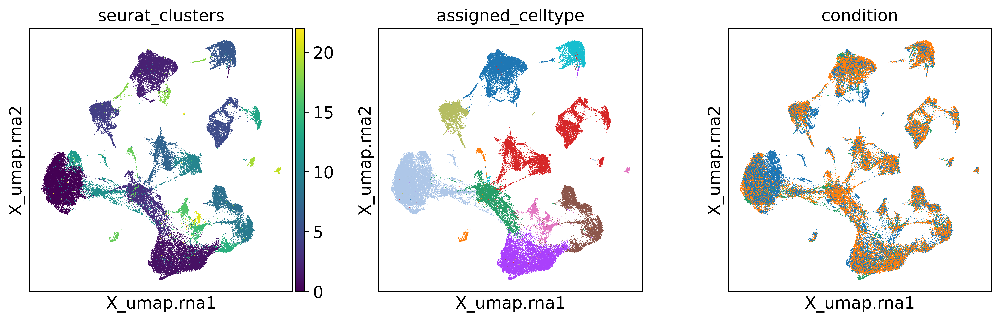

In [16]:
#visualise RNA embeddings
sc.set_figure_params(figsize=(18,14))
sc.set_figure_params(dpi=500)
sc.pl.embedding(rna_data,basis='X_umap.rna', color=['seurat_clusters', 'assigned_celltype', 'condition'],legend_loc='on_data')

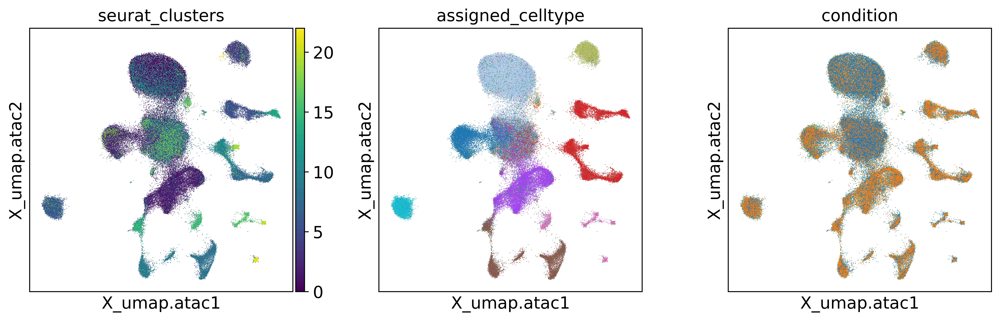

In [17]:
#visualise ATAC embeddings
sc.set_figure_params(figsize=(18,14))
sc.set_figure_params(dpi=500)
sc.pl.embedding(atac_data,basis='X_umap.atac', color=['seurat_clusters', 'assigned_celltype', 'condition'],legend_loc='on_data')

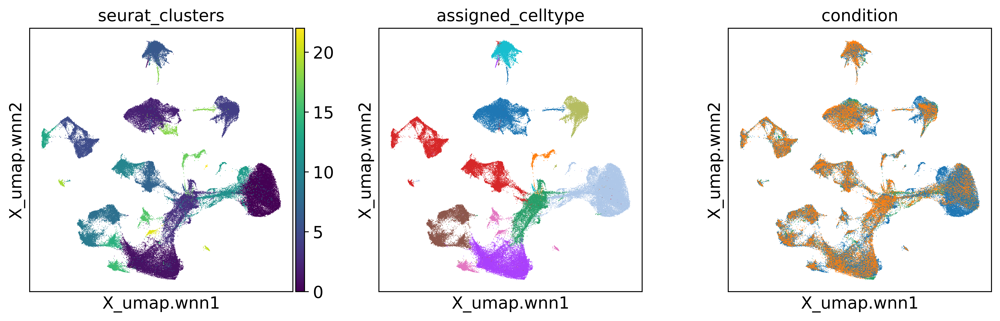

In [19]:
#visualise combined RNA+ATAC embeddings
sc.set_figure_params(figsize=(18,14))
sc.set_figure_params(dpi=500)
sc.pl.embedding(rna_data,basis='X_umap.wnn', color=['seurat_clusters', 'assigned_celltype', 'condition'],legend_loc='on_data')

In [ ]:
# visualise cerebellar spatal marker genes

In [ ]:
# calculate marker DE genes for each cell type 